# Lab 3: Rigid Registration

Gonzalo Esteban Mosquera Rojas \\
Kazi Saeed Alam

## Remainder

Among other useful information, it tells you to make a copy of this Colab notebook BEFORE you try to run it:

- Make a copy on your own Colab space by clicking on the `copy to drive` button.
- Alternatively you could go to the menu `File > Save a copy in Drive`
- Then, open your new file on a new tap and rename it, and you’re ready to start tinkering with the code
- Look carefully at the existing code before you execute it. Try to understand what the code is doing. Part of your learning outcome is to understand it, and we will quiz you about it.
- In several places of the code, you’ll find `#__________TO DO_________`.
There you should introduce your code.

Once you are done, submit this notebook by the lab deadline, with the cells executed and including your **answers** in the text fields in $\color{red}{\text{red}}$ color.

Use `$\color{red}{\text{This is my red text}}$` to write "$\color{red}{\text{This is my red text}}$".

## Goals of this lab
The aim of this lab is to develop competences regarding teamwork and problem solving. By developing the proposed activity you will also become familiar with SIFT and planar transformations for rigid image registration: how to extract invariant features, how to describe them, how to match them and how to use them to compute a homography. Most importantly, this should give you some feeling about the strengths and weaknesses of local feature-based approaches.
It should be noted that before you start this activity, you should read Lowe’s paper on SIFT:

David G. Lowe, "Distinctive image features from scale-invariant keypoints," International Journal of Computer Vision, 60, 2 (2004), pp. 91-110.
The paper can be downloaded from [here](http://www.cs.ubc.ca/~lowe/papers/ijcv04.pdf).

This lab requires working in teams of two (exceptionally three) students. The labs will be organized on the first lab session by the professor who acts as lab instructor.

Students will have to:

1. Test Lowe’s implementation on a set of images showing some skin lesions and compare the obtained results with the provided by a third party library.
2. Register the images pairs corresponding to the same skin lesion using Lowe’s implementation to detect and match features, and implementing different motion models by estimating homography matrices.
3. Improve the registration accuracy by means of data normalization for the homography estimation.

# Loading the required files
You can load into the temporal workspace of Colab the following required files:

*   the data files `LAB3_data`. Download them from Moodle to your computer and uncompress them.

You should copy these files from your computer using the function `files.upload()`. Use the `Choose Files` button to upload both files from your local drive.

Don't use Safari, it is preferable to use google chrome

In [1]:
from google.colab import files
uploaded = files.upload()

Saving 00.png to 00.png
Saving 01.png to 01.png
Saving 02.png to 02.png
Saving 03.png to 03.png
Saving Keypoints_00.csv to Keypoints_00.csv
Saving Keypoints_01.csv to Keypoints_01.csv
Saving Keypoints_02.csv to Keypoints_02.csv
Saving Keypoints_03.csv to Keypoints_03.csv
Saving skin1.jpg to skin1.jpg
Saving skin2.jpg to skin2.jpg


## Additional tools
In this lab, we will also make use of: 
- NumPy, a popular library for scientific computing
- Matplotlib, a popular library for plotting data
- Routines in the aux_utils.py file, which should already be in the local directory
- Opencv
-...

In [2]:
import math, copy
import numpy as np
from numpy import genfromtxt
import matplotlib.pyplot as plt
plt.style.use('seaborn')
#from aux_utils import plt_house_x, plt_contour_wgrad, plt_gradients, plt_cost_vs_theta1
from google.colab import files
# import time
from IPython import display
from time import sleep
# import opencv
import cv2
from google.colab.patches import cv2_imshow

import pandas as pd
import io

#Import math Library
import math 
import scipy.linalg as linalg

Next, we will load images `00.png`, `01.png`, `02.png` and `03.png`

In [3]:
img00c = cv2.imread("00.png") 
img01c = cv2.imread("01.png")
img02c = cv2.imread("02.png")
img03c = cv2.imread("03.png")

In [4]:
org_img00c = img00c.copy()
org_img01c = img01c.copy()
org_img02c = img02c.copy()
org_img03c = img03c.copy()

And the csv files with keypoints

In [5]:
keypoints_00 = genfromtxt('Keypoints_00.csv', delimiter=',', skip_header = 0)
keypoints_01 = genfromtxt('Keypoints_01.csv', delimiter=',', skip_header = 0)
keypoints_02 = genfromtxt('Keypoints_02.csv', delimiter=',', skip_header = 0)
keypoints_03 = genfromtxt('Keypoints_03.csv', delimiter=',', skip_header = 0)

print(np.shape(keypoints_00))
print(keypoints_00)

(64, 2)
[[1266.3   232.7 ]
 [1266.3   320.63]
 [1266.3   407.7 ]
 [1266.3   495.64]
 [1266.3   582.7 ]
 [1266.3   670.63]
 [1266.3   757.7 ]
 [1266.3   845.63]
 [1178.4   232.7 ]
 [1178.5   320.5 ]
 [1178.5   408.  ]
 [1178.5   495.5 ]
 [1178.5   583.  ]
 [1178.5   670.5 ]
 [1178.5   758.  ]
 [1178.3   845.65]
 [1091.3   232.7 ]
 [1091.    320.5 ]
 [1091.    408.  ]
 [1091.    495.5 ]
 [1091.    583.  ]
 [1091.    670.5 ]
 [1091.    758.  ]
 [1091.3   845.63]
 [1003.4   232.7 ]
 [1003.5   320.5 ]
 [1003.5   408.  ]
 [1003.5   495.5 ]
 [1003.5   583.  ]
 [1003.5   670.5 ]
 [1003.5   758.  ]
 [1003.3   845.65]
 [ 916.3   232.7 ]
 [ 916.    320.5 ]
 [ 916.    408.  ]
 [ 916.    495.5 ]
 [ 916.    583.  ]
 [ 916.    670.5 ]
 [ 916.    758.  ]
 [ 916.3   845.64]
 [ 828.37  232.7 ]
 [ 828.5   320.5 ]
 [ 828.5   407.99]
 [ 828.5   495.5 ]
 [ 828.5   583.  ]
 [ 828.5   670.5 ]
 [ 828.5   758.  ]
 [ 828.35  845.65]
 [ 741.3   232.7 ]
 [ 741.    320.5 ]
 [ 741.    408.  ]
 [ 741.    495.5 ]
 [ 7

Now plot img00c, img01c, img02c, img03c all images using `cv2_imshow` from `opencv`

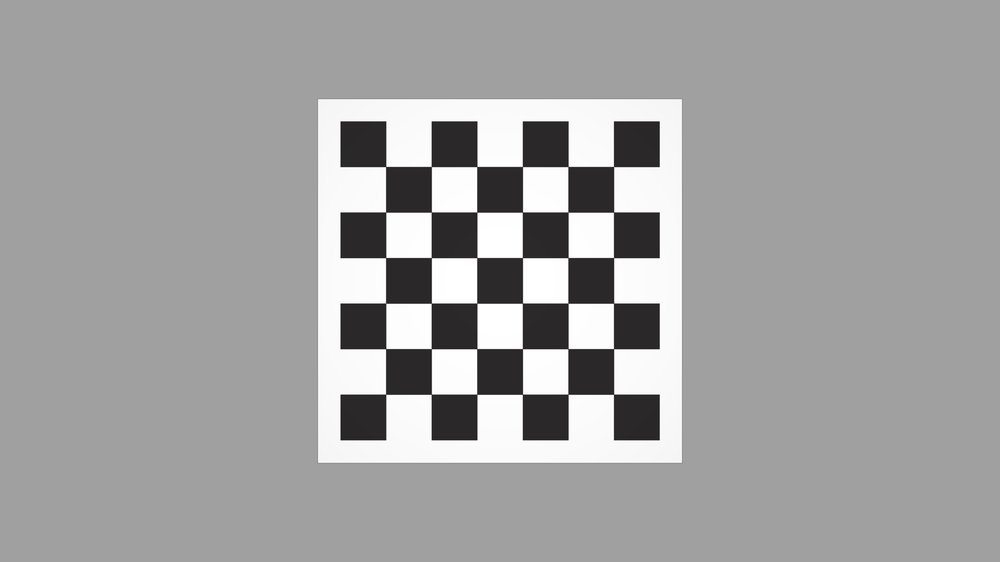

In [6]:
cv2_imshow(img00c)

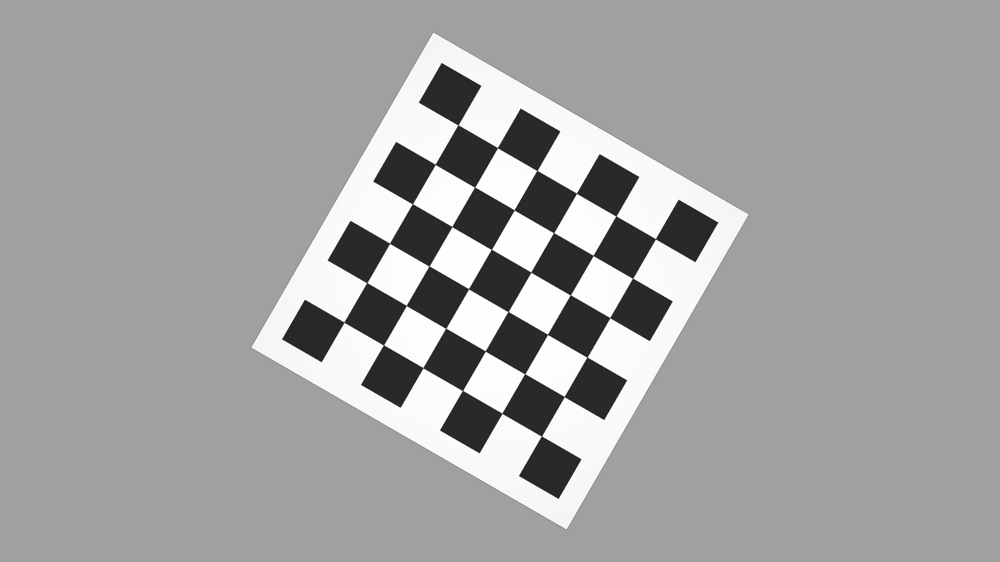

In [7]:
cv2_imshow(img01c)

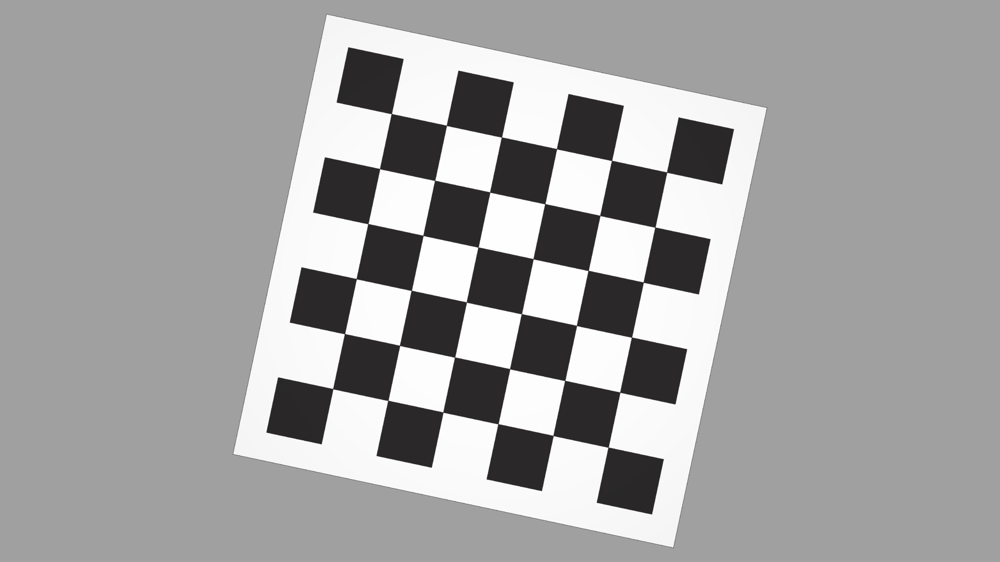

In [8]:
cv2_imshow(img02c)

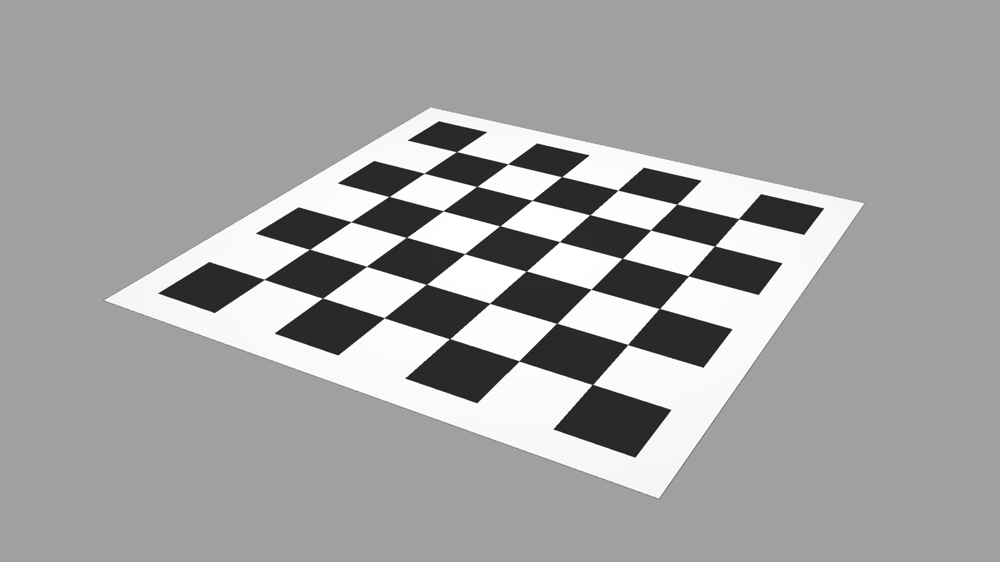

In [9]:
cv2_imshow(img03c)

Plot Keypoints on images.

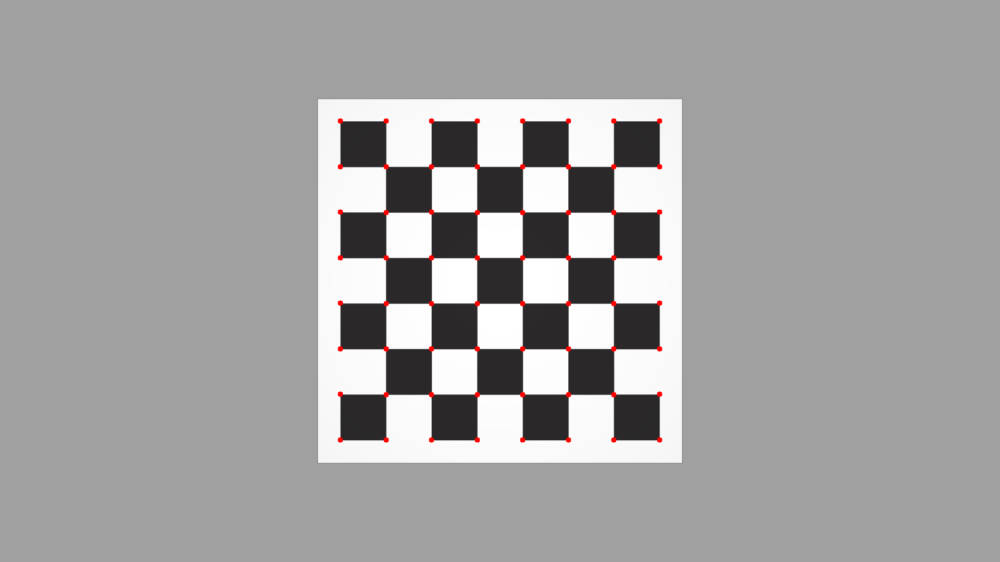

In [10]:
# draw the key points
for x,y in keypoints_00:
  x= int(x)
  y = int(y)
  cv2.circle(img00c, (x,y), radius=0, color=(0, 0, 255), thickness=10)
cv2_imshow(img00c)

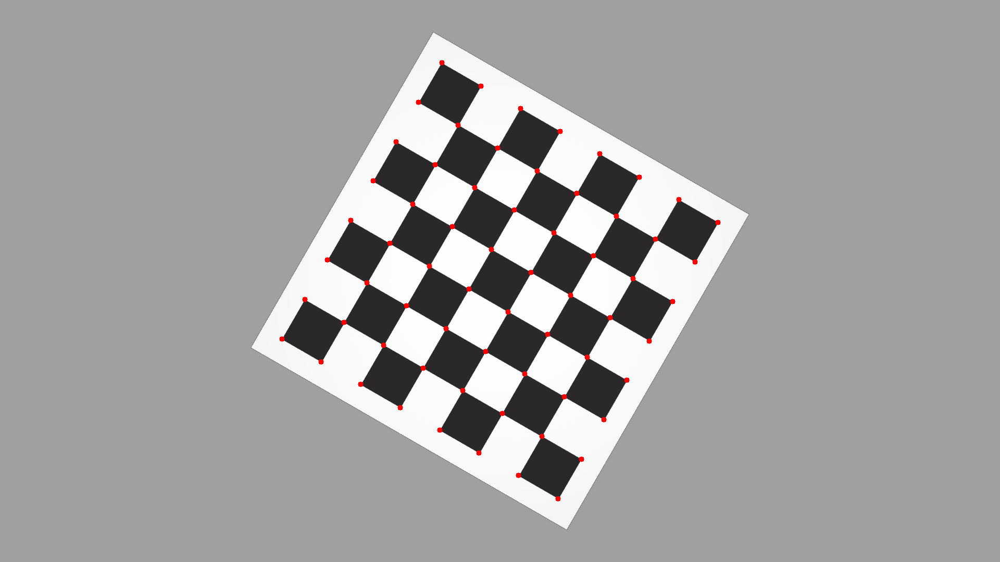

In [11]:
for x,y in keypoints_01:
  x= int(x)
  y = int(y)
  cv2.circle(img01c, (x,y), radius=0, color=(0, 0, 255), thickness=10)
cv2_imshow(img01c)

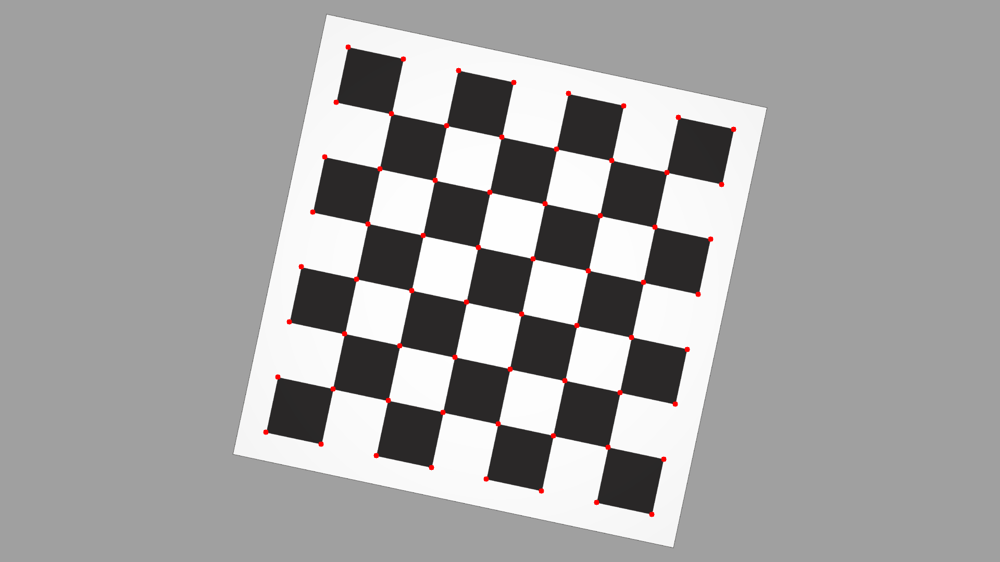

In [12]:
for x,y in keypoints_02:
  x= int(x)
  y = int(y)
  cv2.circle(img02c, (x,y), radius=0, color=(0, 0, 255), thickness=10)
cv2_imshow(img02c)

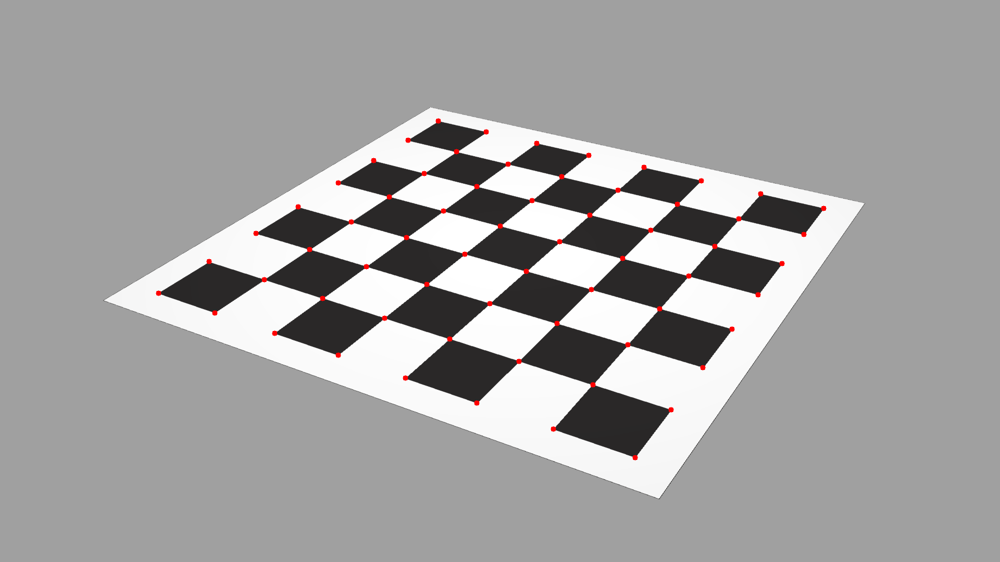

In [13]:
for x,y in keypoints_03:
  x= int(x)
  y = int(y)
  cv2.circle(img03c, (x,y), radius=0, color=(0, 0, 255), thickness=10)
cv2_imshow(img03c)

## Compute Homography

Implement the function:

H = computeHomography(features, matches, model)

where model can be ('Euclidean', 'Similarity', 'Affine', 'Porjective')

follow your notes from MIRA lessons, don't use any opencv existing function

In [14]:
def computeHomography(features,matches,model):
  """
  Inputs: 
  features => keypoints of source image.
  matches => keypoints of destination image.
  model => model for computing the homography: euclidean, similarity, affine and projective.
  
  output: homography matrix corresponding to the selected model.

  """ 

  # Homography matrices for each model Ax=b
  euc_hmatrix = []
  sim_hmatrix = []
  aff_hmatrix = []
  proj_hmatrix= []
  b_euc=[]
  b_sim=[]
  b_aff=[]
  b_proj=[]

  if model== 'Euclidean':
    for i in range(len(features)):
      #Keypoints in source image
      x, y= features[i]
      #Keypoints in destination image
      x_p,y_p= matches[i]
      #Computation of euclidean homography matrix
      euc_hmatrix.append([x, -y, 1, 0])
      euc_hmatrix.append([y, x, 0, 1])
      b_euc += [x_p,y_p]
    euc_hmatrix= np.array(euc_hmatrix)
    #Solving the system for finding the homography parameters
    p=np.linalg.lstsq(euc_hmatrix,b_euc,rcond=-1)[0]
    #Calculating angle and scale parameter to get the parameters of euclidean homography
    theta= math.atan(p[1]/p[0])
    s= p[0]/math.cos(theta)
    #Computation of euclidean homography matrix 
    euclidean_homography= np.array(([p[0]/s,-p[1]/s,p[2]], [p[1]/s,p[0]/s,p[3]], [0,0,1]))
    return euclidean_homography
       
  elif model == 'Similarity':

    for i in range(len(features)):
      #Keypoints in source image
      x,y = features[i]
      #Keypoints in destination image
      x_p,y_p = matches[i]
      #Computation of similarity homography matrix
      sim_hmatrix.append([x, -y, 1, 0])
      sim_hmatrix.append([y, x, 0, 1]) 
      b_sim += [x_p,y_p]
    sim_hmatrix= np.array(sim_hmatrix)
    #Solving the system for finding the homography parameters 
    p= np.linalg.lstsq(sim_hmatrix,b_sim,rcond=-1)[0]
    theta= math.atan(p[1]/p[0])
    #Calculation of scale parameter (difference factor between similarity and euclidean)
    s= p[0]/math.cos(theta)
    #Computation of similarity homography matrix
    similarity_homography= np.array(([p[0],-p[1],p[2]], [p[1],p[0],p[3]], [0,0,1]))
    return similarity_homography
    
  elif model== 'Affine':
    for i in range(len(features)):
      #Keypoints in source image
      x, y = features[i]
      #Keypoints in destination image
      x_p, y_p= matches[i]
      #Computation of affine homography matrix
      aff_hmatrix.append([x, y, 1, 0, 0, 0])
      aff_hmatrix.append([0,0,0,x,y,1])
      b_aff+= [x_p,y_p]
    aff_hmatrix= np.array(aff_hmatrix)
    #Solving the system for finding the homography parameters
    p= np.linalg.lstsq(aff_hmatrix,b_aff,rcond=-1)[0]
    #Computation of affine homography matrix
    affine_homography= np.array(([p[0],p[1],p[2]],[p[3],p[4],p[5]],[0,0,1]))
    return affine_homography
      
  elif model == 'Projective':
    for i in range(len(features)):
      #Keypoints in source image
      x,y= features[i]
      #Keypoints in destination image
      x_p,y_p= matches[i]
      #Computation of projective homography matrix
      proj_hmatrix.append([x, y,1, 0, 0, 0, -x*x_p, -y*x_p])
      proj_hmatrix.append([0,0,0, x, y, 1, -x*y_p, -y*y_p])
      b_proj += [x_p,y_p]
    proj_hmatrix= np.array(proj_hmatrix)
    #Solving the system for finding the homography parameters
    p= np.linalg.lstsq(proj_hmatrix,b_proj,rcond=-1)[0]
    p= np.concatenate((p,[1]),axis=-1)
    #Computation of projective homography matrix
    projective_homography= np.reshape(p,(3,3))
    return projective_homography
      

##Compute Eucliedean Homography

Compute the Euclidean Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

In [15]:
def Warp_Perspective(homography,img_src, img_dst, keypoints_src, keypoints_dst):
  """
  Inputs: 
  homography => homography matrix
  img_src => source image file name
  img_dst => destination image file name
  keypoints_src => keypoints of source image
  keypoints_dst => keypoints of destination image 
  
  output: homography matrix corresponding to the selected model.
  plot of the warping of img src -> img_dst after applying the homography matrix

  """ 
  #Reading of the images and conversion to RGB
  img_src_bgr=cv2.imread(img_src)
  img_src_read = cv2.cvtColor(img_src_bgr, cv2.COLOR_BGR2RGB)
  img_dst_bgr=cv2.imread(img_dst)
  img_dst_read = cv2.cvtColor(img_dst_bgr, cv2.COLOR_BGR2RGB)
  #Computation of homography
  if homography== 'Euclidean':
    h= computeHomography(keypoints_src, keypoints_dst, 'Euclidean')
  elif homography == 'Similarity':
    h= computeHomography(keypoints_src, keypoints_dst, 'Similarity')
  elif homography == 'Affine':
    h= computeHomography(keypoints_src, keypoints_dst, 'Affine')
  elif homography == 'Projective':
    h= computeHomography(keypoints_src, keypoints_dst, 'Projective')
  #Warping of the image for both cases img_src-> img_dst and img_dst->img_src
  height,width,_= img_src_read.shape
  wp1= cv2.warpPerspective(img_src_read, h, (width,height))
  plt.figure(figsize=(25,25))
  plt.subplot(1,3,1)
  plt.imshow(img_src_read)
  plt.title('Image ' + img_src)
  plt.xticks([])
  plt.yticks([])
  plt.subplot(1,3,2)
  plt.imshow(img_dst_read)
  plt.title('Image ' + img_dst)
  plt.xticks([])
  plt.yticks([])
  plt.subplot(1,3,3)
  plt.imshow(wp1)
  plt.title('Image '+ img_src + ' -> ' + img_dst)
  plt.xticks([])
  plt.yticks([])  
  return h

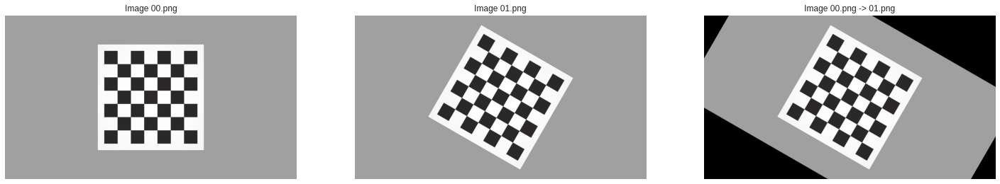

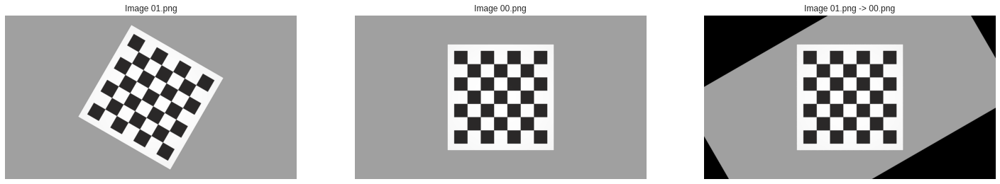

In [16]:
#Euclidean homography from Image 0 to Image 1
euclidean_h01=Warp_Perspective('Euclidean', "00.png", "01.png", keypoints_00, keypoints_01)
#Euclidean homography from Image 1 to Image 0
euclidean_h10=Warp_Perspective('Euclidean', "01.png", "00.png", keypoints_01, keypoints_00)

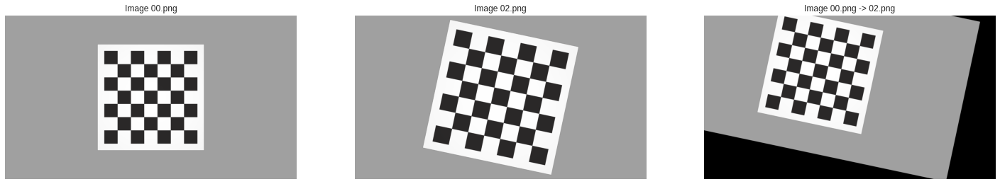

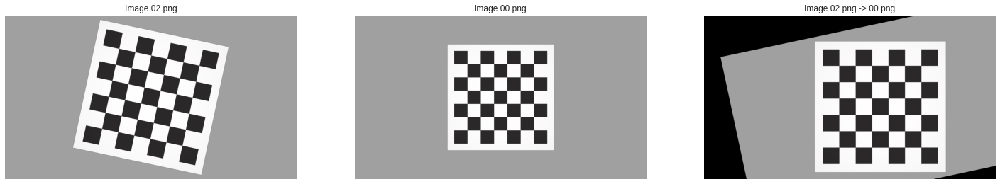

In [17]:
#Euclidean homography from Image 0 to Image 2
euclidean_h02=Warp_Perspective('Euclidean', "00.png", "02.png", keypoints_00, keypoints_02)
#Euclidean homography from Image 2 to Image 0
euclidean_h20=Warp_Perspective('Euclidean', "02.png", "00.png", keypoints_02, keypoints_00)

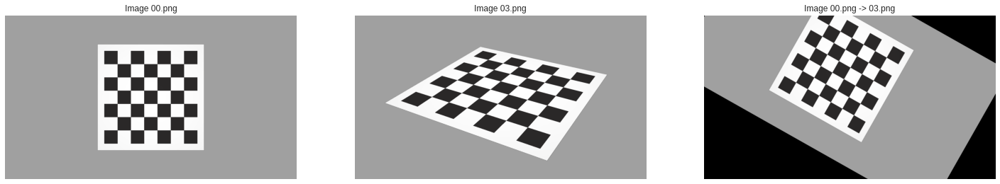

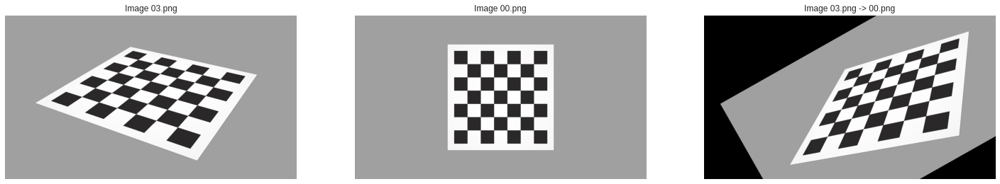

In [18]:
#Euclidean homography from Image 0 to Image 3
euclidean_h03=Warp_Perspective('Euclidean', "00.png", "03.png", keypoints_00, keypoints_03)
#Euclidean homography from Image 3 to Image 0
euclidean_h30=Warp_Perspective('Euclidean', "03.png", "00.png", keypoints_03, keypoints_00)

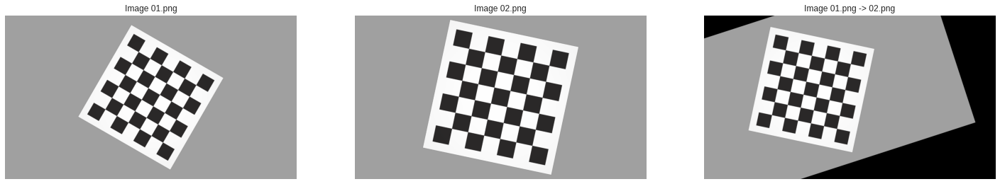

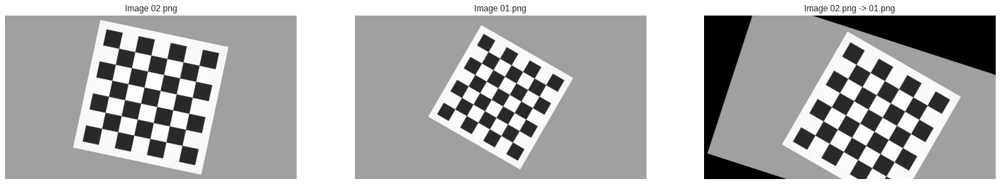

In [19]:
#Euclidean homography from Image 1 to Image 2
euclidean_h12=Warp_Perspective('Euclidean', "01.png", "02.png", keypoints_01, keypoints_02)
#Euclidean homography from Image 2 to Image 1
euclidean_h21=Warp_Perspective('Euclidean', "02.png", "01.png", keypoints_02, keypoints_01)

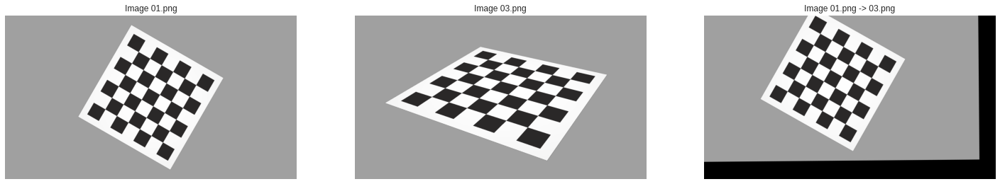

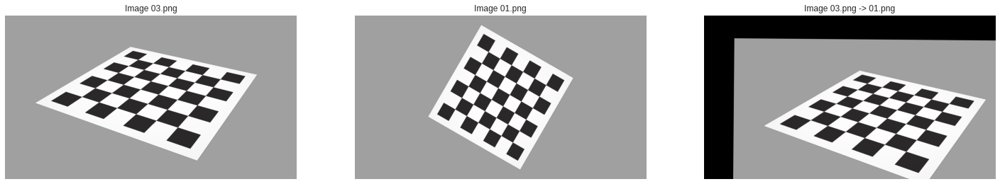

In [20]:
#Euclidean homography from Image 1 to Image 3
euclidean_h13=Warp_Perspective('Euclidean', "01.png", "03.png", keypoints_01, keypoints_03)
#Euclidean homography from Image 3 to Image 1
euclidean_h31=Warp_Perspective('Euclidean', "03.png", "01.png", keypoints_03, keypoints_01)

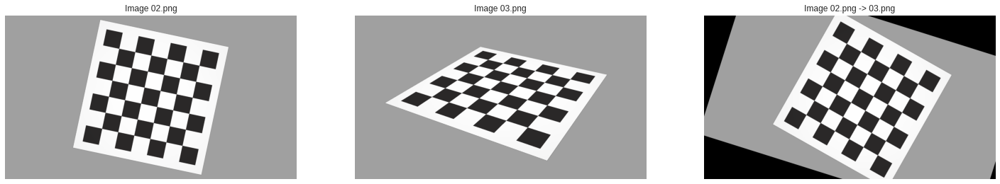

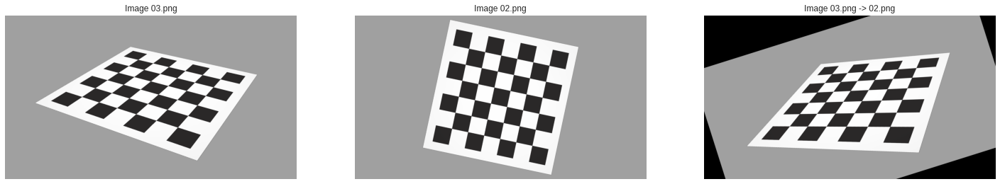

In [21]:
#Euclidean homography from Image 2 to Image 3
euclidean_h23=Warp_Perspective('Euclidean', "02.png", "03.png", keypoints_02, keypoints_03)
#Euclidean homography from Image 3 to Image 2
euclidean_h32=Warp_Perspective('Euclidean', "03.png", "02.png", keypoints_03, keypoints_02)

##Compute Similarity Homography
Compute the Similarity Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

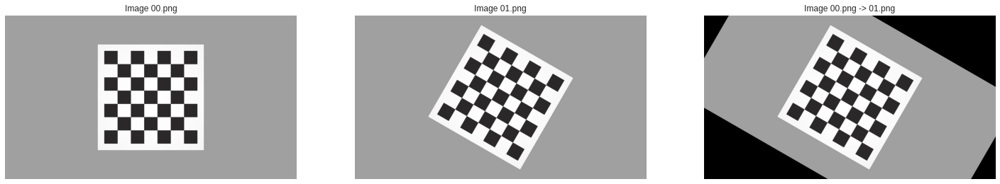

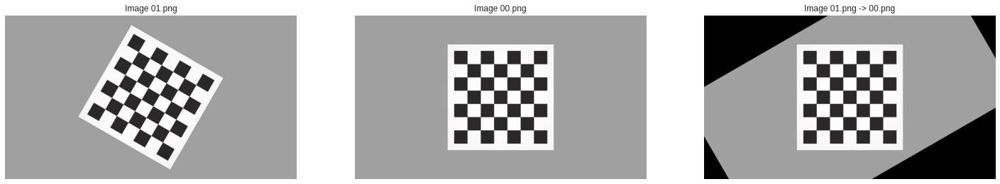

In [22]:
#Similarity homography from Image 0 to Image 1
similarity_h01=Warp_Perspective('Similarity', "00.png", "01.png", keypoints_00, keypoints_01)
#Similarity homography from Image 1 to Image 0
similarity_h10=Warp_Perspective('Similarity', "01.png", "00.png", keypoints_01, keypoints_00)

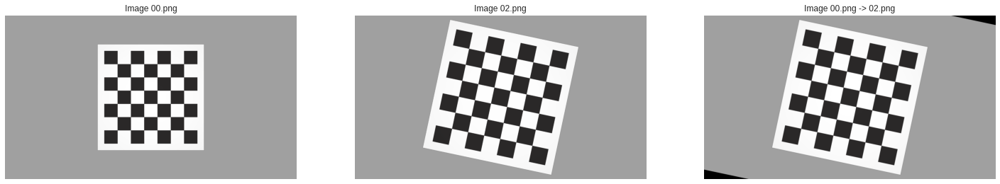

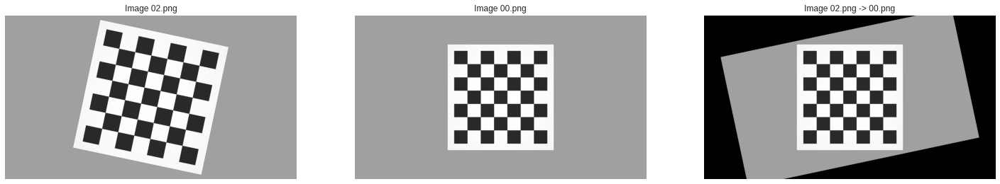

In [23]:
#Similarity homography from Image 0 to Image 2
similarity_h02=Warp_Perspective('Similarity', "00.png", "02.png", keypoints_00, keypoints_02)
#Similarity homography from Image 2 to Image 0
similarity_h20=Warp_Perspective('Similarity', "02.png", "00.png", keypoints_02, keypoints_00)

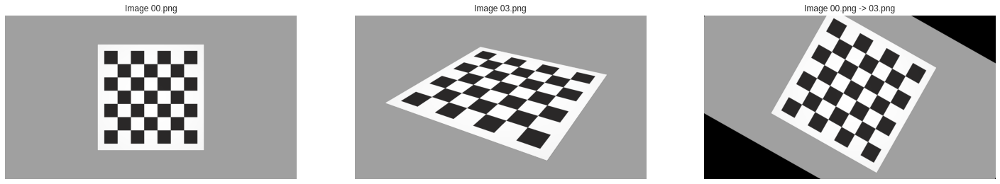

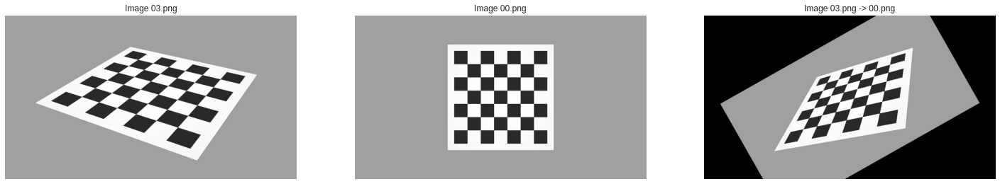

In [24]:
#Similarity homography from Image 0 to Image 3
similarity_h03=Warp_Perspective('Similarity', "00.png", "03.png", keypoints_00, keypoints_03)
#Similarity homography from Image 3 to Image 0
similarity_h30=Warp_Perspective('Similarity', "03.png", "00.png", keypoints_03, keypoints_00)

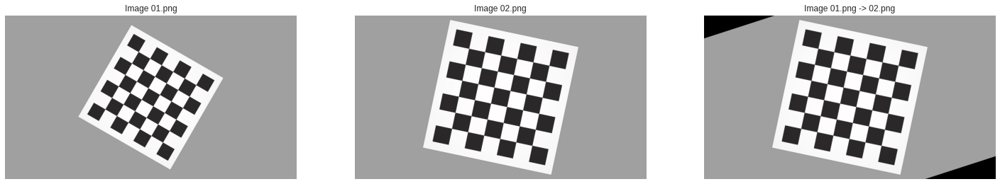

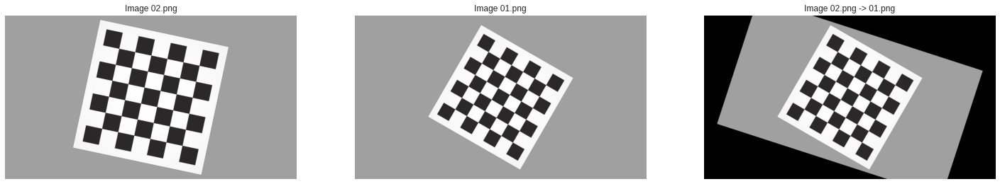

In [25]:
#Similarity Homography from Image 1 to Image 2
similarity_h12=Warp_Perspective('Similarity', "01.png", "02.png", keypoints_01, keypoints_02)
#Similarity Homography from Image 2 to Image 1
similarity_h21=Warp_Perspective('Similarity', "02.png", "01.png", keypoints_02, keypoints_01)

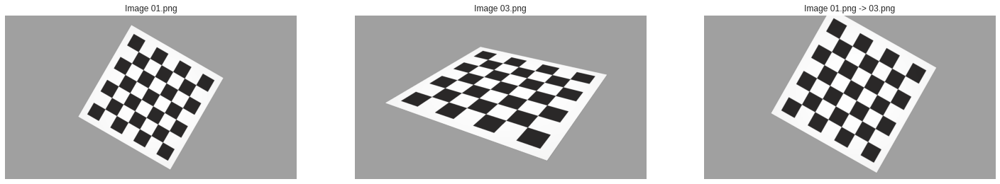

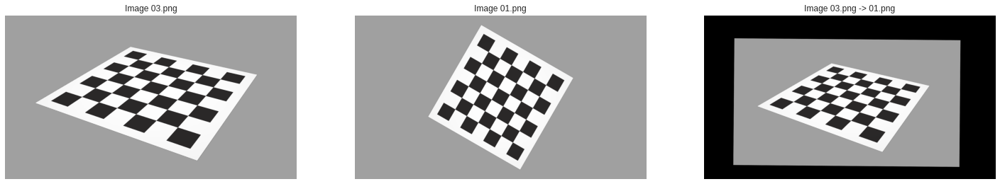

In [26]:
#Similarity homography from Image 1 to Image 3
similarity_h13=Warp_Perspective('Similarity', "01.png", "03.png", keypoints_01, keypoints_03)
#Similarity homography from Image 3 to Image 1
similarity_h31=Warp_Perspective('Similarity', "03.png", "01.png", keypoints_03, keypoints_01)

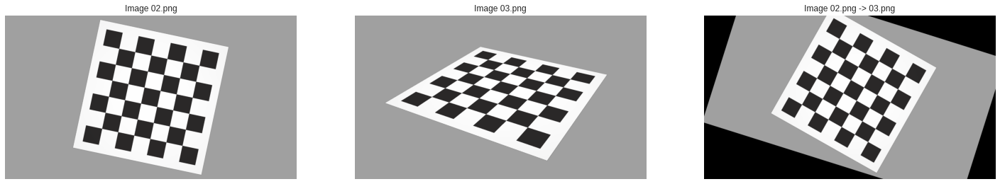

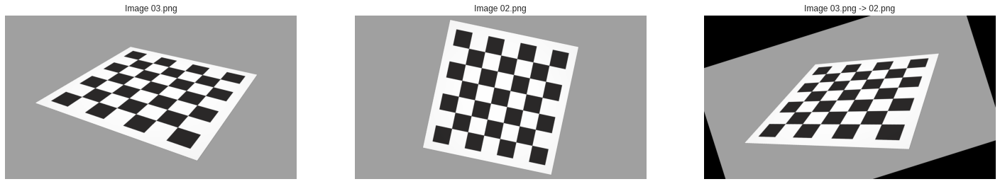

In [27]:
#Similarity homography from Image 2 to Image 3
similarity_h23=Warp_Perspective('Similarity', "02.png", "03.png", keypoints_02, keypoints_03)
#Similarity homography from Image 3 to Image 2
similarity_h32=Warp_Perspective('Similarity', "03.png", "02.png", keypoints_03, keypoints_02)

##Compute Affine Homography

Compute the Affine Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

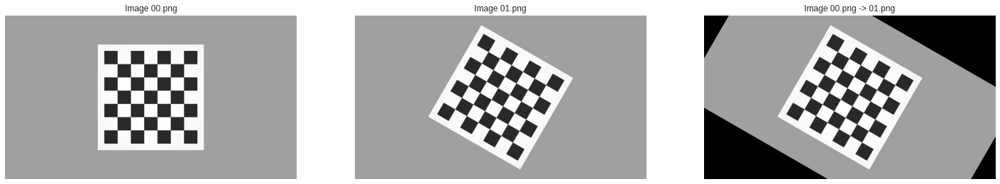

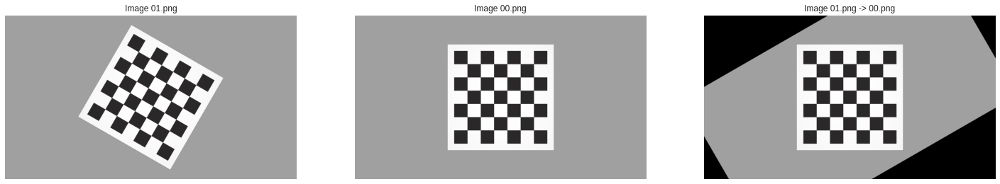

In [28]:
#Affine homography from Image 0 to Image 1
affine_h01=Warp_Perspective('Affine', "00.png", "01.png", keypoints_00, keypoints_01)
#Affine homography from Image 1 to Image 0
affine_h10=Warp_Perspective('Affine', "01.png", "00.png", keypoints_01, keypoints_00)

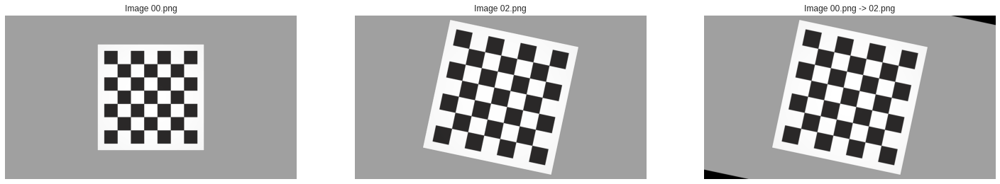

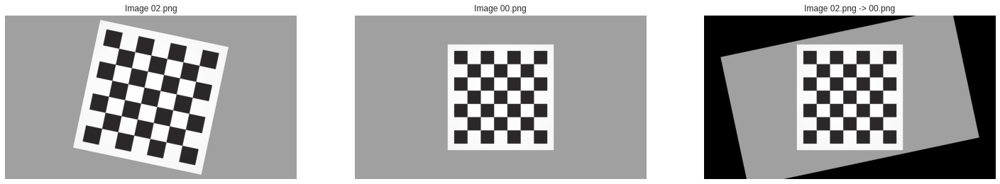

In [29]:
#Affine homography from Image 0 to Image 2
affine_h02=Warp_Perspective('Affine', "00.png", "02.png", keypoints_00, keypoints_02)
#Affine homography from Image 2 to Image 0
affine_h20=Warp_Perspective('Affine', "02.png", "00.png", keypoints_02, keypoints_00)

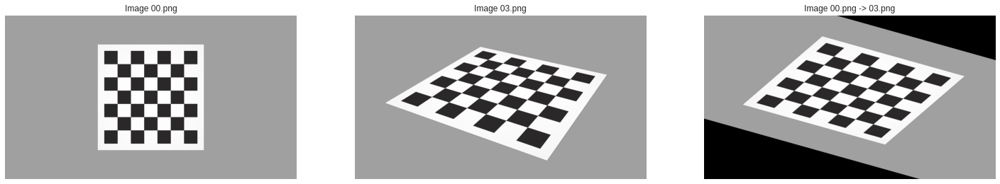

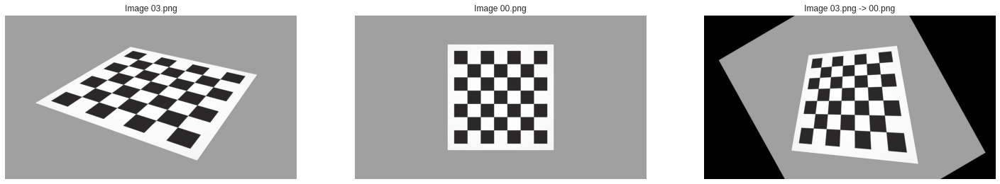

In [30]:
#Affine homography from Image 0 to Image 3
affine_h03=Warp_Perspective('Affine', "00.png", "03.png", keypoints_00, keypoints_03)
#Affine homography from Image 3 to Image 0
affine_h30=Warp_Perspective('Affine', "03.png", "00.png", keypoints_03, keypoints_00)

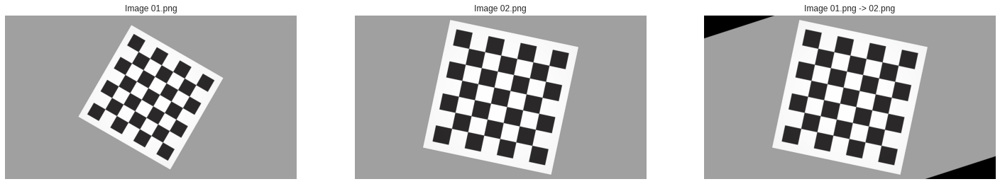

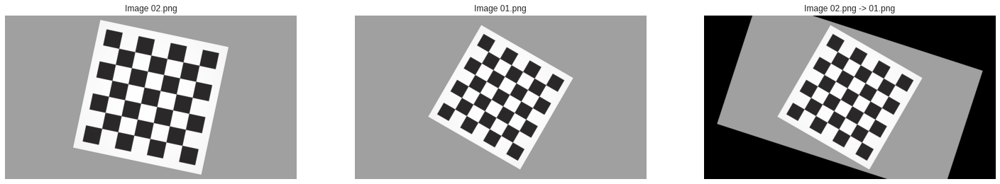

In [31]:
#Affine homography from Image 1 to Image 2
affine_h12=Warp_Perspective('Affine', "01.png", "02.png", keypoints_01, keypoints_02)
#Affine homography from Image 2 to Image 1
affine_h21=Warp_Perspective('Affine', "02.png", "01.png", keypoints_02, keypoints_01)

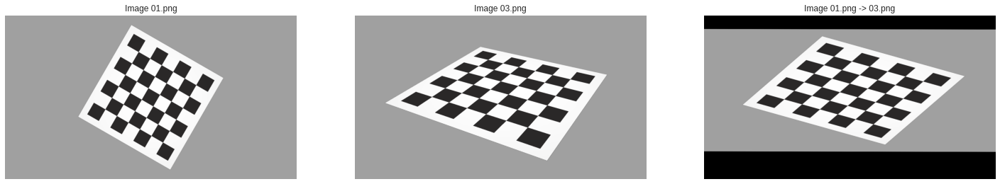

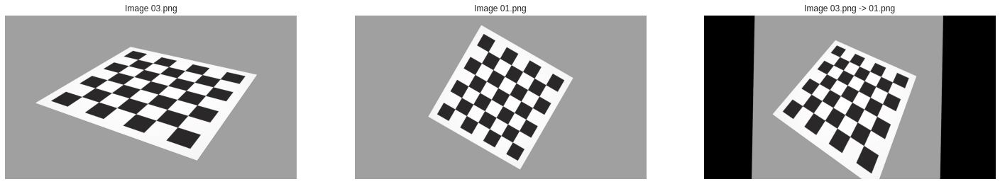

In [32]:
#Affine homography from Image 1 to Image 3
affine_h13=Warp_Perspective('Affine', "01.png", "03.png", keypoints_01, keypoints_03)
#Affine homography from Image 3 to Image 1
affine_h31=Warp_Perspective('Affine', "03.png", "01.png", keypoints_03, keypoints_01)

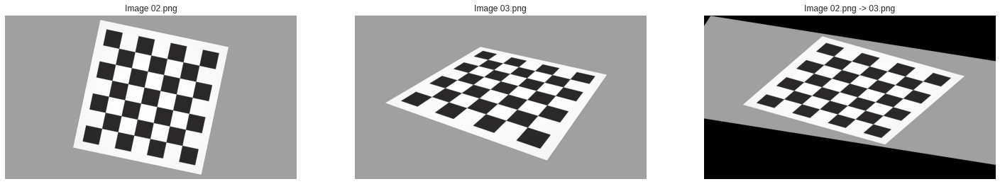

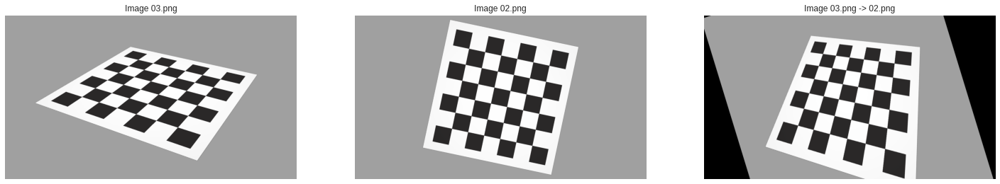

In [33]:
#Affine homography from Image 2 to Image 3
affine_h23=Warp_Perspective('Affine', "02.png", "03.png", keypoints_02, keypoints_03)
#Affine homography from Image 3 to Image 2
affine_h32=Warp_Perspective('Affine', "03.png", "02.png", keypoints_03, keypoints_02)

##Compute Projective Homography

Compute the Euclidean Homography between all loaded images

After computing them use the function `cv2.warpPerspective` to check the obtainen result

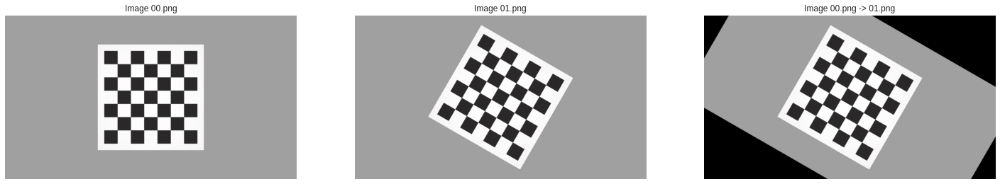

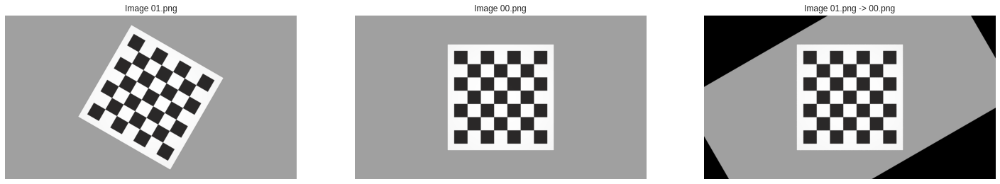

In [34]:
#Projective homography from Image 0 to Image 1
projective_h01=Warp_Perspective('Projective', "00.png", "01.png", keypoints_00, keypoints_01)
#Projective homography from Image 1 to Image 0
projective_h10=Warp_Perspective('Projective', "01.png", "00.png", keypoints_01, keypoints_00)

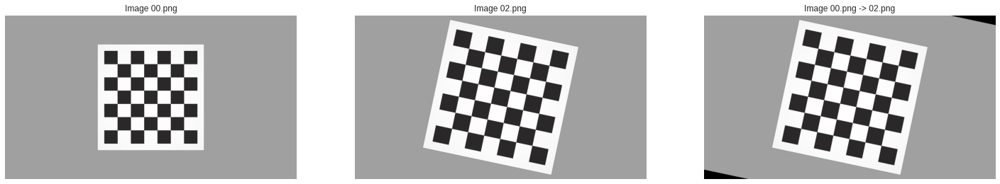

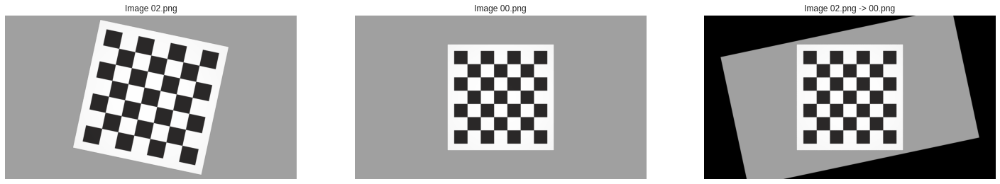

In [35]:
#Projective homography from Image 0 to Image 2
projective_h02=Warp_Perspective('Projective', "00.png", "02.png", keypoints_00, keypoints_02)
#Projective homography from Image 2 to Image 0
projective_h20=Warp_Perspective('Projective', "02.png", "00.png", keypoints_02, keypoints_00)

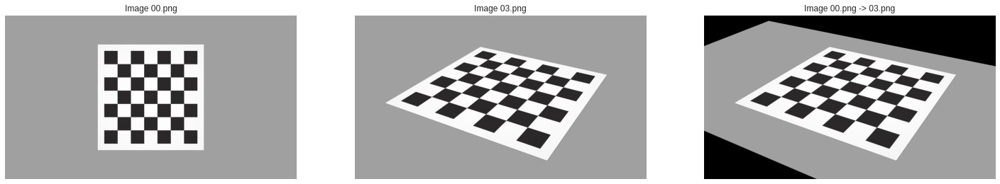

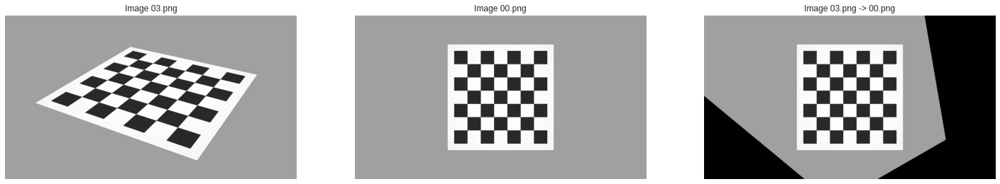

In [36]:
#Projective homography from Image 0 to Image 3
projective_h03=Warp_Perspective('Projective', "00.png", "03.png", keypoints_00, keypoints_03)
#Projective homography from Image 3 to Image 0
projective_h30=Warp_Perspective('Projective', "03.png", "00.png", keypoints_03, keypoints_00)

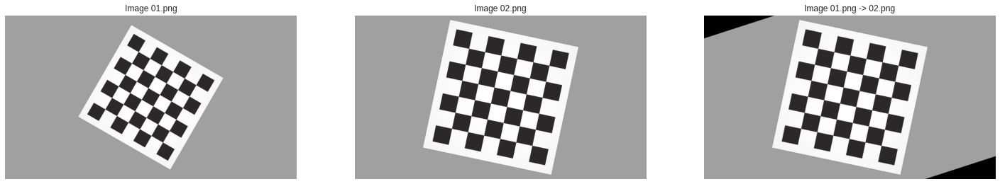

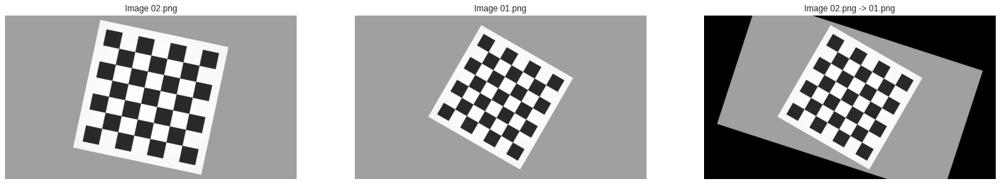

In [37]:
#Projective homography from Image 1 to Image 2
projective_h12=Warp_Perspective('Projective', "01.png", "02.png", keypoints_01, keypoints_02)
#Projective homography from Image 2 to Image 1
projective_h21=Warp_Perspective('Projective', "02.png", "01.png", keypoints_02, keypoints_01)

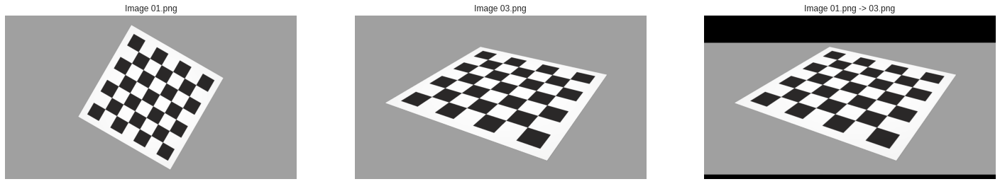

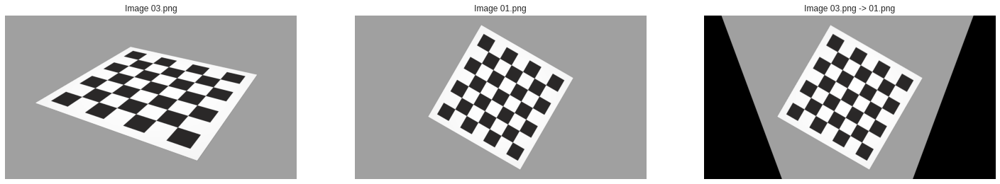

In [38]:
#Projective homography from Image 1 to Image 3
projective_h13=Warp_Perspective('Projective', "01.png", "03.png", keypoints_01, keypoints_03)
#Projective homography from Image 3 to Image 1
projective_h31=Warp_Perspective('Projective', "03.png", "01.png", keypoints_03, keypoints_01)

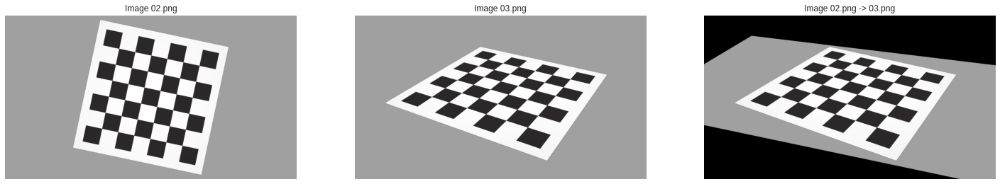

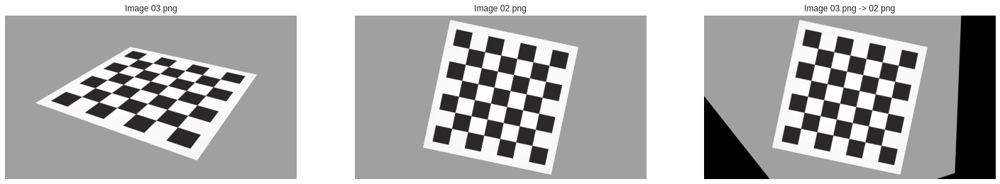

In [39]:
#Projective homography from Image 2 to Image 3
projective_h23=Warp_Perspective('Projective', "02.png", "03.png", keypoints_02, keypoints_03)
#Projective homography from Image 3 to Image 2
projective_h32=Warp_Perspective('Projective', "03.png", "02.png", keypoints_03, keypoints_02)

##Comment the previous obtained results.
Which is the best homography for each image pair? Why?

<font color='red'>For the analysis of which is the best homograhy is best for each image pair, the following cases were studied: </font>

<font color='red'>- Image 01 -> Image 00: For this case, all images offer the exact same result. However, the best homography model is euclidean, since from image 01 -> image 00 only rotation is needed, and that can be achieved with euclidean, which has less parameters and would take less time of computation. The degrees of freedom of the other homographies are not necessary. </font>

<font color='red'>- Image 02 -> Image 00: In this case, it can be seen that euclidean homography fails, since this transformation requires scaling and that is a degree of freedom present from similarity homography. The rest of homographies give the same result. Therefore, it can be concluded that similarity homography is the best one since requires less degrees of freedom and offers a good result.</font>

<font color='red'>- Image 03 -> Image 00: In this case, it can be easily seen that the best homography is projective, since it is the only one that actually converts the source image to the destination one. The rest of them do not produce a good result, so the 8 degrees of freedom that projective homography offers are needed. </font>

<font color='red'>- Image 01 -> Image 02: In this case, it can be seen that the best homography is the similarity one, since only scaling and rotations are needed and that is sufficed by the degrees of freedom of similarity homography. The degrees of freedom of the other homographies would be redundant for this case. </font>

<font color='red'>- Image 01 -> Image 03: In this case, it can be easily seen that the best homography is projective, since it is the only one that actually converts the source image to the destination one. The rest of them do not produce a good results, so the 8 degrees of freedom that projective homography offers are needed. </font>

<font color='red'>- Image 02 -> Image 03: In this case, it can be easily seen that the best homography is projective, since it is the only one that actually converts the source image to the destination one. The rest of them do not produce a good results, so the 8 degrees of freedom that projective homography offers are needed. </font>




## Detect SIFT Keypoints and Descriptors
Now we will register real images.

Register skin1.jpg with skin2.jpg

First, load and show the images.

Also set SIFT to detect keypoints on images

$\color{yellow}{\text{To be done during 1st lab session}}$

In [41]:
skin_img_1 = cv2.imread("skin1.jpg")
skin_img_2 = cv2.imread("skin2.jpg")

org_skin_img_1 = skin_img_1.copy()
org_skin_img_2 = skin_img_2.copy()

skin_img_1_gray = cv2.cvtColor(skin_img_1, cv2.COLOR_BGR2GRAY)
skin_img_2_gray = cv2.cvtColor(skin_img_2, cv2.COLOR_BGR2GRAY)

# Setting SIFT to detect keypoints and descriptors
sift = cv2.xfeatures2d.SIFT_create()

keypoints_img1, descriptors_img1 = sift.detectAndCompute(skin_img_1_gray, None)
keypoints_img2, descriptors_img2 = sift.detectAndCompute(skin_img_2_gray, None)

## Plot the Keypoints
$\color{yellow}{\text{To be done during 1st lab session}}$

In [42]:
# draw the detected key points
sift_image_skin_1 = cv2.drawKeypoints(skin_img_1, keypoints_img1, skin_img_1)
sift_image_skin_2 = cv2.drawKeypoints(skin_img_2, keypoints_img2, skin_img_2)

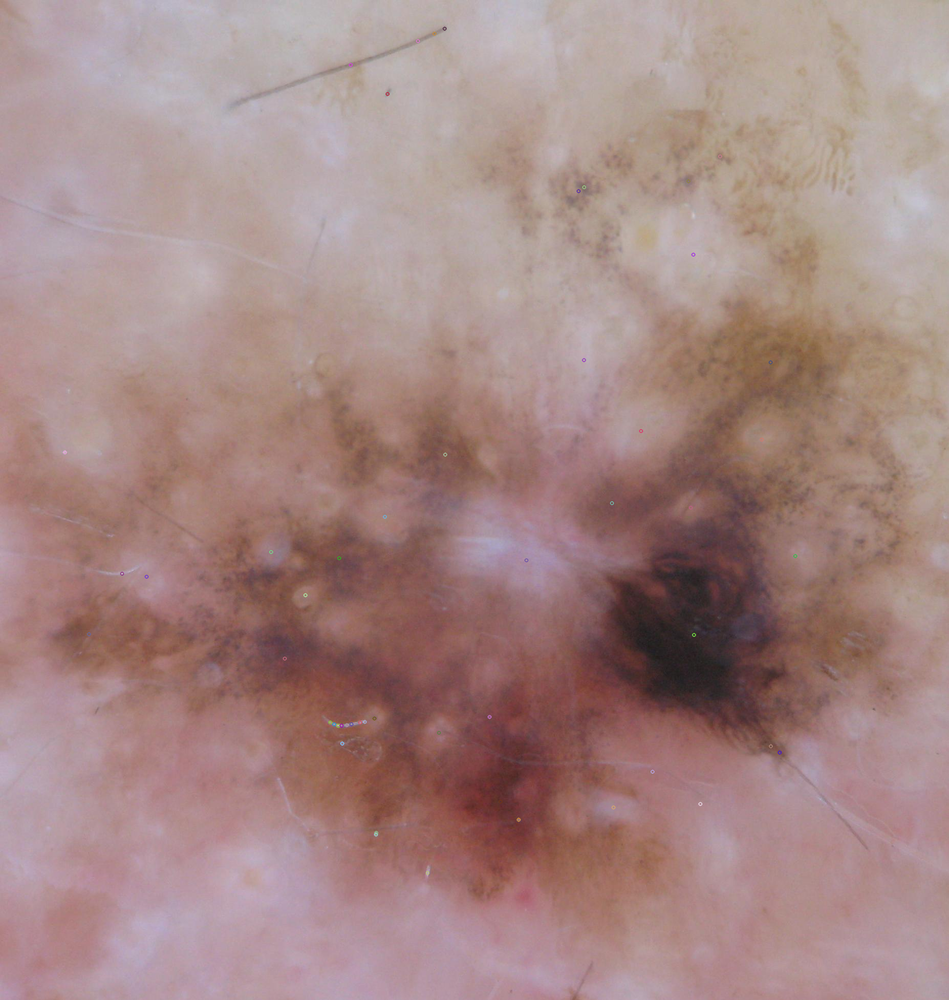

In [43]:
# show the first image
cv2_imshow(sift_image_skin_1)

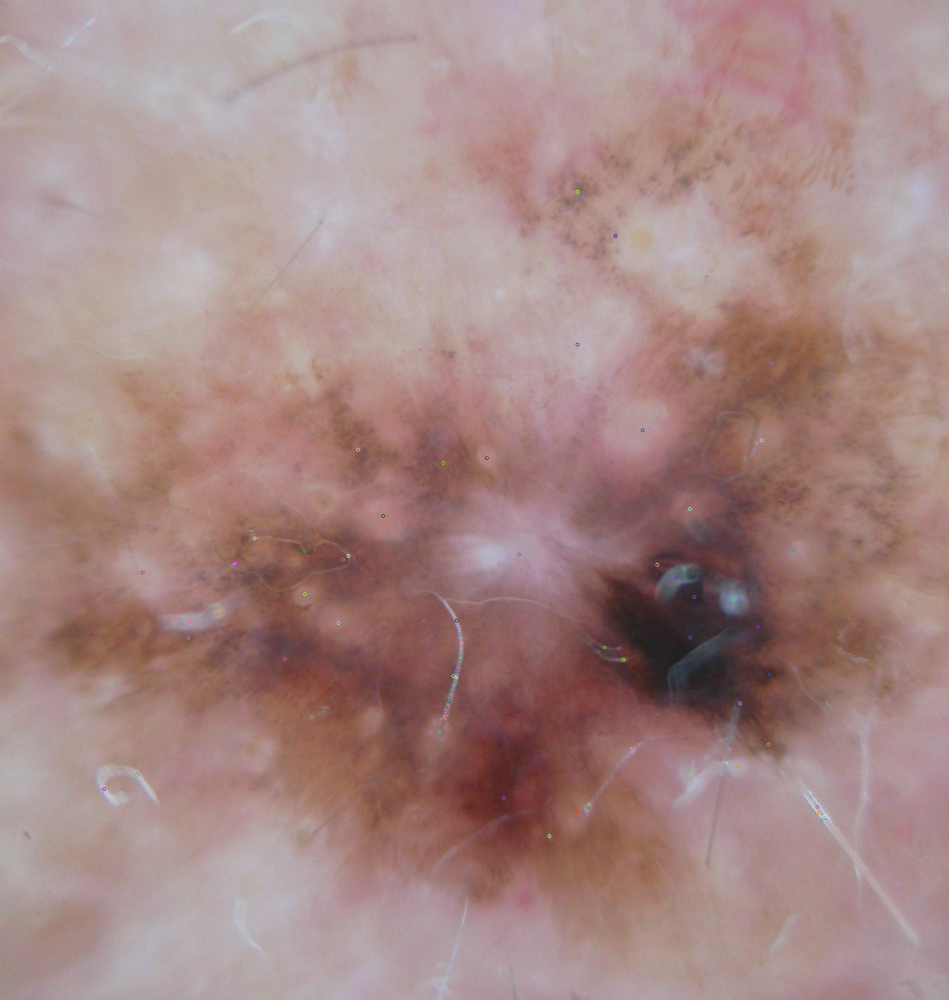

In [44]:
# show the second image
cv2_imshow(sift_image_skin_2)

## Compute Brute Force Matching

$\color{yellow}{\text{To be done during 1st lab session}}$

In [45]:
 # BFMatcher with default params
bf = cv2.BFMatcher()
sift_matches = bf.knnMatch(descriptors_img1, descriptors_img2, k=2)
# Apply ratio test
good_matches = []
for m,n in sift_matches:
  if m.distance < 0.8*n.distance:
    good_matches.append([m])

Plot matches

$\color{yellow}{\text{To be done during 1st lab session}}$

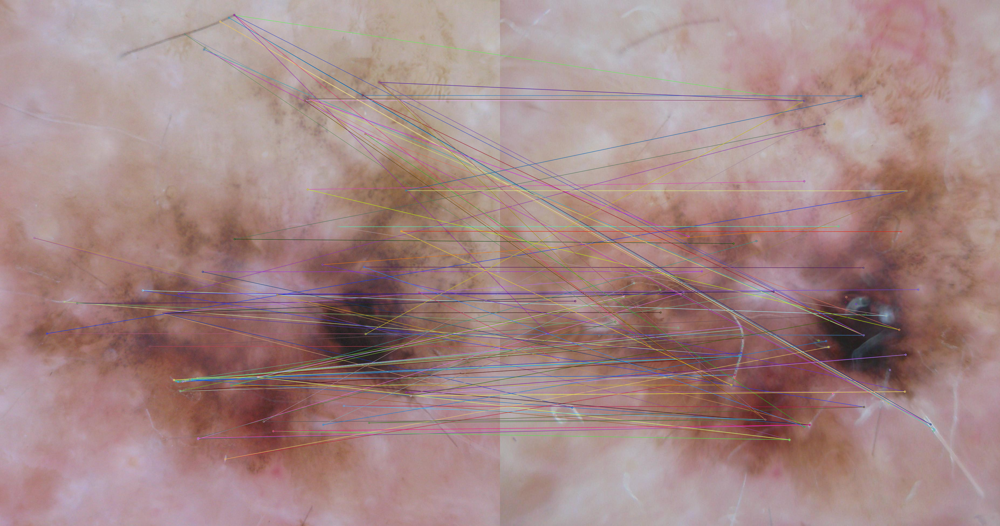

In [46]:
# cv.drawMatchesKnn expects list of lists as matches.
matched_img = cv2.drawMatchesKnn(skin_img_1,keypoints_img1,skin_img_2,keypoints_img2,sift_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
cv2_imshow(matched_img)

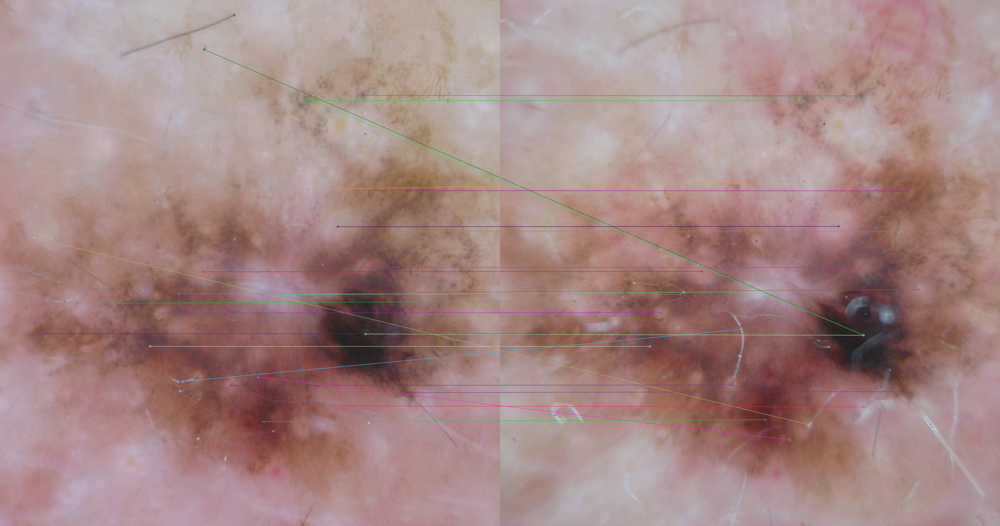

In [47]:
# After ratio test
matched_img = cv2.drawMatchesKnn(skin_img_1,keypoints_img1,skin_img_2,keypoints_img2,good_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
cv2_imshow(matched_img)

## Lowe match

Now implement by yourself a function to match keypoints and descriptors between these 2 images

Implement the function `SIFT_match` following the article "Distinctive image features from scale-invariant keypoints" David G. Lowe.

$\color{yellow}{\text{To be done during 1st lab session}}$

In [48]:
from scipy.spatial import distance

def SIFT_match(descriptors_img1, descriptors_img2, keypoints_img1, keypoints_img2):
  source_keypoints = []
  target_keypoints = []
  for des1 in range(len(descriptors_img1)):
    distance_list = []
    for des2 in range(len(descriptors_img2)):
      current_dist = distance.euclidean(descriptors_img1[des1], descriptors_img2[des2])
      # Appending the indices of the keypoints from image 1, image 2 and their distance
      distance_list.append([des1, des2, current_dist])
    # Sorting according to the distance
    sorted_distance_list = sorted(distance_list, key=lambda distance_list: distance_list[2])
    # Finding the ratio between the top 2 closest neighbour
    current_ratio = sorted_distance_list[0][2]/sorted_distance_list[1][2]
    # Accepting the matches if the ratio fulfills the criteria
    if current_ratio<0.8:
      source_keypoints.append(keypoints_img1[sorted_distance_list[0][0]])
      target_keypoints.append(keypoints_img2[sorted_distance_list[0][1]])
  return source_keypoints, target_keypoints

Recompute the matches using your function

$\color{yellow}{\text{To be done during 1st lab session}}$

In [49]:
source_keypoints, target_keypoints = SIFT_match(descriptors_img1, descriptors_img2, keypoints_img1, keypoints_img2)

In [50]:
print(len(source_keypoints))
print(len(target_keypoints))

27
27


In [51]:
for points in source_keypoints:
  print(points.pt[0], points.pt[1])

126.45375061035156 883.0300903320312
173.4454345703125 1238.1873779296875
285.92620849609375 1125.8753662109375
555.9227905273438 1285.7601318359375
596.2525024414062 1161.938720703125
662.2666625976562 1089.7803955078125
677.2022094726562 1415.8773193359375
677.2022094726562 1415.8773193359375
751.4483032226562 1008.8367919921875
756.7125854492188 183.15213012695312
857.0991821289062 1430.6868896484375
955.9742431640625 1399.74267578125
977.4034423828125 1565.0155029296875
1028.0081787109375 1093.7822265625
1129.87451171875 372.89306640625
1140.4561767578125 702.8243408203125
1140.731689453125 365.23394775390625
1251.874267578125 841.3770751953125
1274.348876953125 1506.6885986328125
1344.5281982421875 353.54302978515625
1349.091064453125 991.0433349609375
1355.3974609375 1239.5845947265625
1355.3974609375 1239.5845947265625
1487.6322021484375 858.145263671875
1505.0574951171875 707.2200317382812
1505.4949951171875 1456.9862060546875
1553.324462890625 1085.4793701171875


In [52]:
for points in target_keypoints:
  print(points.pt[0], points.pt[1])

1147.76708984375 1577.0645751953125
178.81846618652344 1239.1767578125
278.3310852050781 1117.626953125
555.7511596679688 1285.799072265625
595.3363647460938 1159.8970947265625
670.0330810546875 1092.4859619140625
894.8541259765625 1221.99658203125
894.8541259765625 1221.99658203125
748.13720703125 1007.3098754882812
1348.203125 1244.298095703125
858.0731201171875 1428.9476318359375
1073.0740966796875 1632.4549560546875
983.7158203125 1557.9693603515625
1013.703125 1082.5787353515625
1127.470703125 374.3315124511719
1127.82861328125 672.5845947265625
1348.203125 1244.298095703125
1254.9105224609375 840.004150390625
1349.363037109375 1510.6656494140625
1338.6605224609375 355.65496826171875
1347.5107421875 993.7316284179688
1348.203125 1244.298095703125
1348.203125 1244.298095703125
1487.750732421875 859.4906005859375
1506.9896240234375 708.2672119140625
1500.8377685546875 1453.6197509765625
1550.5146484375 1074.9019775390625


Plot the new matches

$\color{yellow}{\text{To be done during 1st lab session}}$

In [53]:
def plot_matches(img_1, img_2, source_keypoints, target_keypoints):
  # Creating a new image using the widtha and height of both input images 
  h1, w1 = img_1.shape[:2]
  h2, w2 = img_2.shape[:2]
  # Width will be the sum of the widths of both images
  nWidth = w1+w2
  # Taking the maximum height of the two images
  nHeight = max(h1, h2)
  hdif = int((h1-h2)/2)
  newimg = np.zeros((nHeight, nWidth, 3), np.uint8)
  newimg[hdif:hdif+h2, :w2] = img_1
  newimg[:h1, w2:w1+w2] = img_2
  for i in range(len(source_keypoints)):
    # putting the points in the new image
    pt_a = (int(source_keypoints[i].pt[0]), int(source_keypoints[i].pt[1]+hdif))
    pt_b = (int(target_keypoints[i].pt[0]+w2), int(target_keypoints[i].pt[1]))
    # drawing the line between the matching points
    cv2.line(newimg, pt_a, pt_b, (255, 0, 255), thickness=2)
  cv2_imshow(newimg)

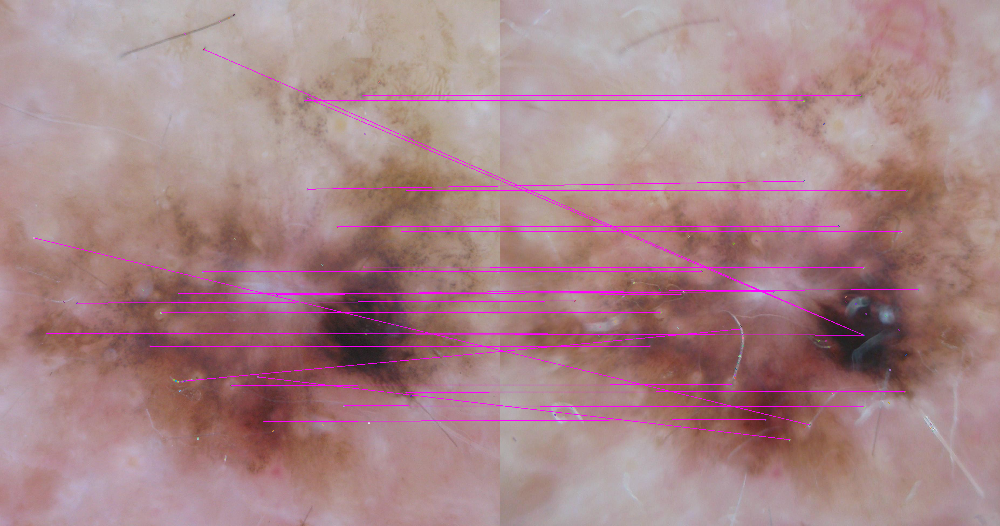

In [54]:
plot_matches(skin_img_1, skin_img_2, source_keypoints, target_keypoints)

## Compute Homographies

Compute the homography between both images using opencv function `cv2.findHomography`

Plot one of the images warped acording to the obtained Homograhy

$\color{yellow}{\text{To be done during 1st lab session}}$

In [55]:
good_matches = []
for m,n in sift_matches:
  if m.distance < 0.8*n.distance:
    good_matches.append(m)

In [107]:
def ComputeHomograpy_CV(img1,img2, kp1, kp2,gm):
  src_pts = np.float32([ kp1[m.queryIdx].pt for m in gm ]).reshape(-1,1,2)
  dst_pts = np.float32([ kp2[m.trainIdx].pt for m in gm ]).reshape(-1,1,2)
  M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,5)
  h,w,_ = img1.shape
  wp = cv2.warpPerspective(img1,M,(w,h))
  return wp


In [109]:
homography_cv= ComputeHomograpy_CV(skin_img_1, skin_img_2, keypoints_img1, keypoints_img2, good_matches)

([], <a list of 0 Text major ticklabel objects>)

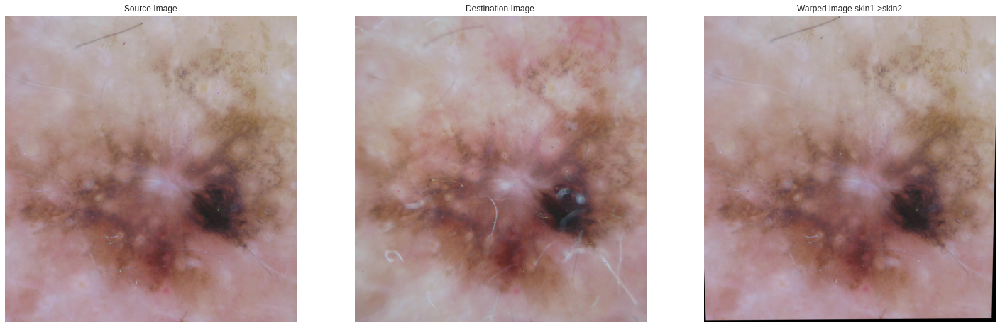

In [111]:
plt.figure(figsize=(25,25))
plt.subplot(1,3,1)
plt.imshow(cv2.cvtColor(skin_img_1, cv2.COLOR_BGR2RGB))
plt.title('Source Image')
plt.xticks([])
plt.yticks([])
plt.subplot(1,3,2)
plt.imshow(cv2.cvtColor(skin_img_2, cv2.COLOR_BGR2RGB))
plt.title('Destination Image')
plt.xticks([])
plt.yticks([])
plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor(homography_cv, cv2.COLOR_BGR2RGB))
plt.title("Warped image skin1->skin2")
plt.xticks([])
plt.yticks([])  

Now Compute the Homography between both images using your Homography Computation function. Use all models and and compare the results

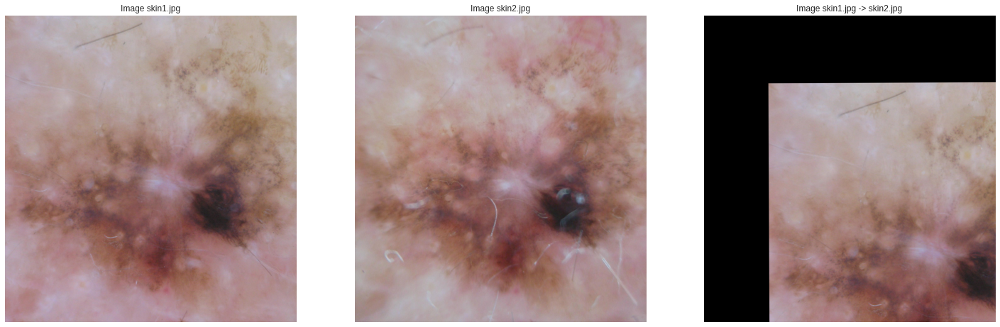

In [89]:
euclidean_hs12=Warp_Perspective('Euclidean', "skin1.jpg", "skin2.jpg", cv2.KeyPoint_convert(source_keypoints), cv2.KeyPoint_convert(target_keypoints))

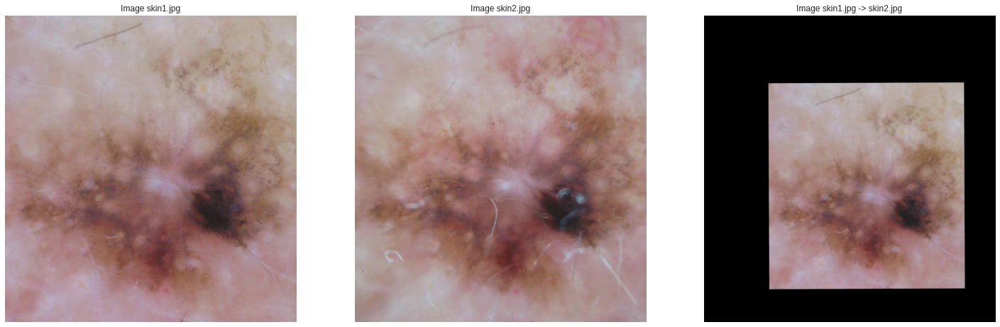

In [90]:
similarity_hs12=Warp_Perspective('Similarity', "skin1.jpg", "skin2.jpg", cv2.KeyPoint_convert(source_keypoints), cv2.KeyPoint_convert(target_keypoints))

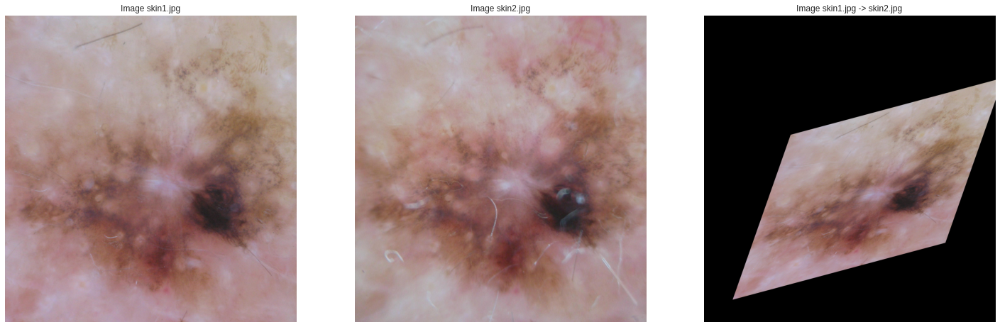

In [91]:
affine_hs12=Warp_Perspective('Affine', "skin1.jpg", "skin2.jpg", cv2.KeyPoint_convert(source_keypoints), cv2.KeyPoint_convert(target_keypoints))

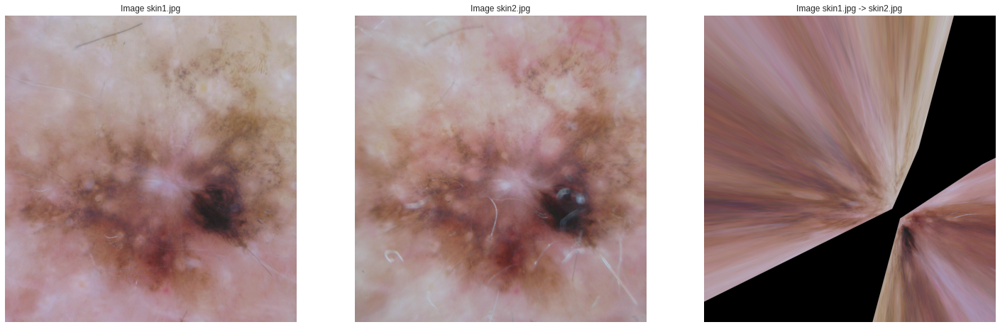

In [92]:
projective_hs12=Warp_Perspective('Projective', "skin1.jpg", "skin2.jpg", cv2.KeyPoint_convert(source_keypoints), cv2.KeyPoint_convert(target_keypoints))

<font color='red'>When comparing the results obtained using OpenCV homography function and the implemented homography function, it can be seen that for all the models of the implemented function (euclidean, similarity, affine and projective), the results are very far from the optimal one. The image gets noticeably deformed (specially for affine and projective transformations), and for the euclidean and similarity models a big portion of the image gets eliminated. This is caused do to the presence of outliers in the keypoints matches. </font>

## You should notice that you have outliers when you compute the Homography.

Implement RANSAC function and recompute all the Homographies using it.

Finally Warp one of the images and compare your results with the ones obtained using opencv functions.

In [112]:
def my_RANSAC(method, distance_threshold, sample_acceptance_count):
  
  # Fixing how many points to be sampled and number of iterations
  if method==1 or method==2: #Eucliedean 
    samping_points = 2
    MAX_ITER = 5
    model = 'Euclidean'
  elif method==2: #Similarity
    samping_points = 2
    MAX_ITER = 5
    model = 'Similarity'
  elif method==3: #Affine
    samping_points = 3
    MAX_ITER = 7
    model = 'Affine'
  elif method==4: #Projective
    samping_points = 4
    MAX_ITER = 9
    model = 'Projective'

  count = 0
  np.random.seed(42) # For reproducibility of the same result
  # For Storing the indices and match-counts after RANSAC
  best_match_indices = [] 
  best_match_count = 0

  while count<MAX_ITER:
    
    # Sampling random points
    temp_match_samples = np.random.choice(range(len(source_keypoints)), size=samping_points)
    temp_source_keypoints = []
    temp_target_keypoints = []
    for i in temp_match_samples:
      temp_source_keypoints.append(source_keypoints[i].pt)
      temp_target_keypoints.append(target_keypoints[i].pt)

    # Compute Homography Matrix
    M = computeHomography(temp_source_keypoints, temp_target_keypoints, model) 
    # Generating points using the deformation matrix
    temp_match_count = 0
    temp_good_indices = []
    for index in range(len(source_keypoints)):
      if index not in temp_match_samples:
        point = np.zeros(3)
        point_updated = np.zeros(2)
        point[0] = source_keypoints[index].pt[0]
        point[1] = source_keypoints[index].pt[1]
        point[2] = 1
        # Point Transformation
        point_transformed = np.dot(M, point)
        point_transformed_x = point_transformed[0] / point_transformed[2]
        point_transformed_y = point_transformed[1] / point_transformed[2]
        # Computing Eucledian distance between the old keypoints with the keypoints after transformation
        X_diff_sqr =  pow((point_transformed_x - target_keypoints[index].pt[0]),2)
        Y_diff_sqr =  pow((point_transformed_y - target_keypoints[index].pt[1]),2)
        eucliedean_distance = math.sqrt(X_diff_sqr + Y_diff_sqr)
        # Checking the criteria to accept as a inlier
        if(eucliedean_distance < distance_threshold): 
          temp_match_count+=1
          temp_good_indices.append(index)
      else:
        # For the points already taken as sampling points
        temp_match_count +=1
        temp_good_indices.append(index)
  
    # Updating the best indices and best match-counts after RANSAC
    if temp_match_count >= best_match_count:
      best_match_count = temp_match_count
      best_match_indices = temp_good_indices.copy()
    
    # Checking the criteria to stop the loop according to tolerance
    if len(best_match_indices) >= sample_acceptance_count:
      return best_match_indices

    count+=1

  return best_match_indices

In [113]:
# Choice of Homography
method = 3 # 1 for Eucliedean, 2 for Similarity, 3 for Affine and 4 for Projective
# Probability for inlier (alpha value)
probability_inlier = 0.95
# Threshold for accepting the points in match
distance_threshold = math.sqrt(100 * (pow(probability_inlier,2)))
# Stop when the number of samples satisfies sample_acceptance_count
sample_acceptance_count = round(0.9 * len(source_keypoints))

# RANSAC Function
best_match_indices = my_RANSAC(method, pow(distance_threshold,2), sample_acceptance_count)
# Inliers after RANSAC
best_source_keypoints = []
best_target_keypoints = []
for index in best_match_indices:
  best_source_keypoints.append(source_keypoints[index])
  best_target_keypoints.append(target_keypoints[index])

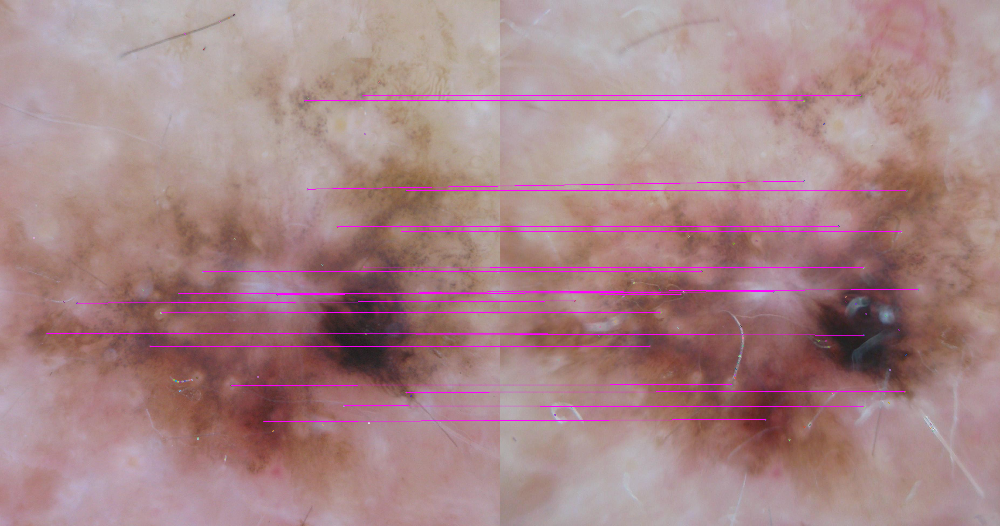

In [114]:
# Plotting the matches after removing outliers
plot_matches(skin_img_1, skin_img_2, best_source_keypoints, best_target_keypoints)

([], <a list of 0 Text major ticklabel objects>)

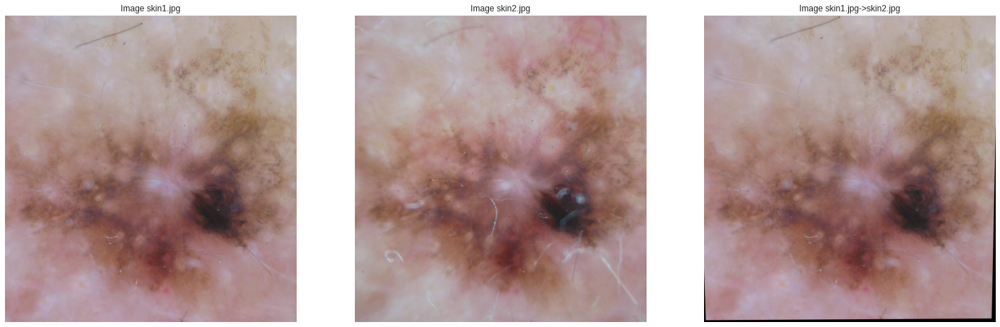

In [115]:
#Plot of homography using openCV function
plt.figure(figsize=(25,25))
plt.subplot(1,3,1)
plt.imshow(cv2.cvtColor(skin_img_1, cv2.COLOR_BGR2RGB))
plt.title('Image skin1.jpg')
plt.xticks([])
plt.yticks([])
plt.subplot(1,3,2)
plt.imshow(cv2.cvtColor(skin_img_2, cv2.COLOR_BGR2RGB))
plt.title('Image skin2.jpg')
plt.xticks([])
plt.yticks([])
plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor(homography_cv, cv2.COLOR_BGR2RGB))
plt.title("Image skin1.jpg->skin2.jpg")
plt.xticks([])
plt.yticks([])  

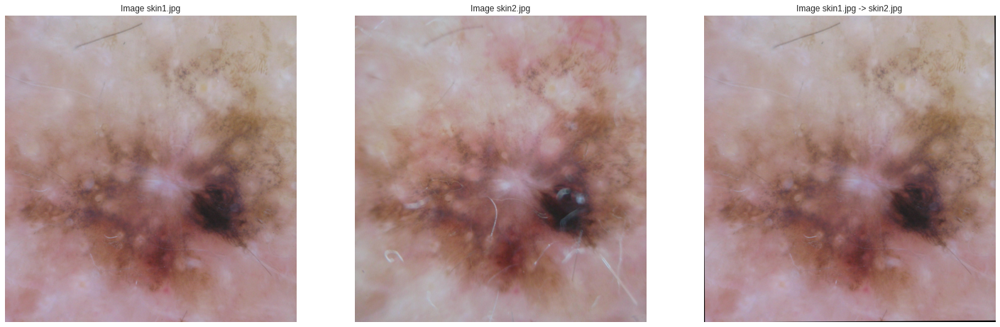

In [116]:
# Recomputation of Euclidean Homography with RANSAC
euclidean_ransac_hs12=Warp_Perspective('Euclidean', "skin1.jpg", "skin2.jpg", cv2.KeyPoint_convert(best_source_keypoints), cv2.KeyPoint_convert(best_target_keypoints))

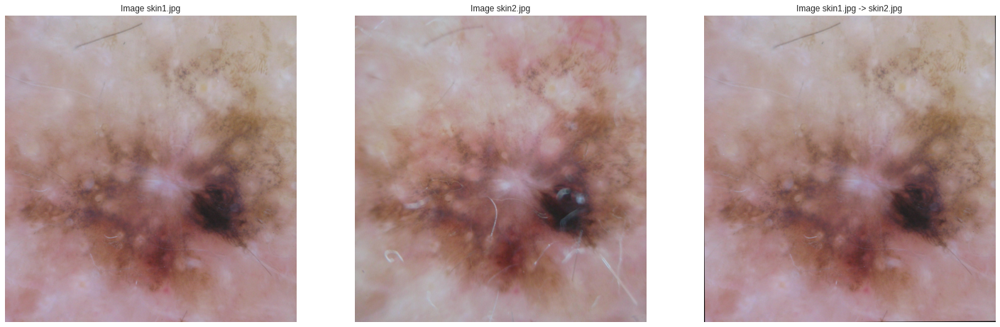

In [117]:
# Recomputation of Similarity Homography with RANSAC
similarity_rasac_hs12=Warp_Perspective('Similarity', "skin1.jpg", "skin2.jpg", cv2.KeyPoint_convert(best_source_keypoints), cv2.KeyPoint_convert(best_target_keypoints))

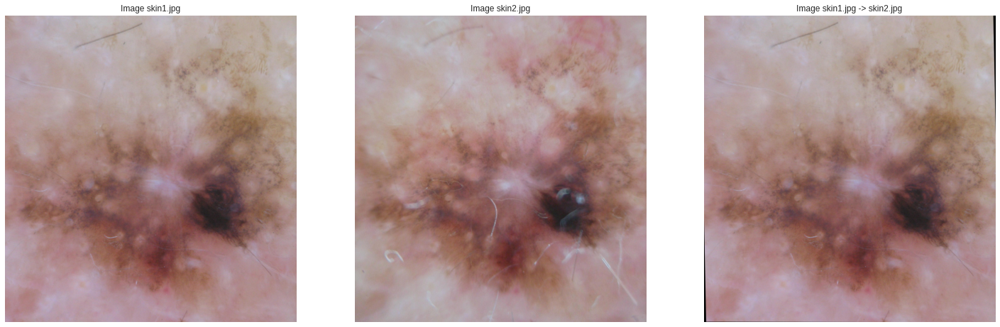

In [118]:
# Recomputation of Affine Homography with RANSAC
affine_ransac_hs12=Warp_Perspective('Affine', "skin1.jpg", "skin2.jpg", cv2.KeyPoint_convert(best_source_keypoints), cv2.KeyPoint_convert(best_target_keypoints))

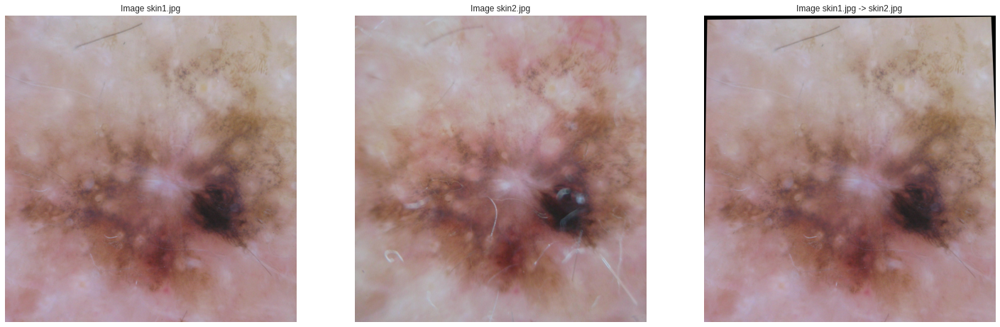

In [119]:
# Recomputation of Projective Homography with RANSAC
projective_ransac_hs12=Warp_Perspective('Projective', "skin1.jpg", "skin2.jpg", cv2.KeyPoint_convert(best_source_keypoints), cv2.KeyPoint_convert(best_target_keypoints))

<font color='red'>When comparing the results of the function implemented during this activity with RANSAC, it can be seen that the best results are obtained when using projective homography model, since more degrees of freedom are needed to map the source image to the destination one. However, when comparing this best model with the one obtained with OpenCV function some subtle differences can be seen and this might be due to the fact of differences in implementation. OpenCV function uses a reprojection threshold, whereas the implementation done in this notebook uses a distance threshold. It is also important to mention that after applying RANSAC the outliers were successfully removed and the transformations were able to be done correctly, as opposed to the implementation without RANSAC.</font>


## Congratulations!
In this lab you:
- tested SIFT Algorithm
- implemented homography computation

Submit this notebook by the lab deadline, with the cells executed and including your **answers** in the text fields in $\color{red}{\text{red}}$ color.